### TP sur l'optimisation par graph-cut (partie 2, multi-niveaux)

L'objectif de ce TP est la mise en oeuvre des approches d'$\alpha$-expansion et d'$\alpha$-$\beta$ swap pour le débruitage d'images en niveaux de gris. 

La librairie PyMaxFlow est utilisée pour le calcul de la coupure par graph-cut. 

In [1]:
import math
import random
import numpy as np
#%matplotlib notebook
import matplotlib.pyplot as plt

import platform
import tempfile
import os
from scipy import ndimage as ndi
try:
    import maxflow
except:
    !pip install PyMaxflow #Pour Google Collab
    import maxflow
    
from bokeh.plotting import figure, output_file, show
from bokeh.plotting import show as showbokeh
from bokeh.io import output_notebook
output_notebook()

def affiche_pour_colab(im,MINI=0.0, MAXI=None,titre=''): #special colab, ne pas regarder
  def normalise_image_pour_bokeh(X,MINI,MAXI): 
    if MAXI==None:
      MAXI = np.max(X)
    else:
      MAXI = MAXI
    imt=np.copy(X.copy())
    imt=(np.clip(imt,0,MAXI)/(MAXI))
    imt[imt<0]=0
    imt[imt>1]=1

    imt*=255
    
    sortie=np.empty((*imt.shape,4),dtype=np.uint8)
    for k in range(3):
      sortie[:,:,k]=imt
    sortie[:,:,3]=255
    return sortie
  img=normalise_image_pour_bokeh(np.flipud(im),MINI,MAXI)# np.flipud(np.fliplr(im)))
  p = figure(tooltips=[("x", "$x"), ("y", "$y"), ("value", "@image")],title=titre)
  p.x_range.range_padding = p.y_range.range_padding = 0
  # must give a vector of images
  p.image_rgba(image=[img], x=0,y=0, dw=im.shape[1], dh=im.shape[0])
  print(img.shape)
  showbokeh(p)

def affiche(im,MINI=0.0, MAXI=None,titre='',printname=False):
    affiche_pour_colab(im,MINI=MINI, MAXI=MAXI,titre=titre) # sous google colab beaucoup d''options disparaissent
    
def display_segmentation_borders(image, bin):
    imagergb = np.copy(image)
    from skimage.morphology import binary_dilation, disk
    contour = binary_dilation(bin,disk(15))^bin
    imagergb[contour==1,0] = 255
    imagergb[contour==1,1] = 0
    imagergb[contour==1,2] = 0
    return imagergb


     |████████████████████████████████| 133kB 6.0MB/s 
  Created wheel for PyMaxflow: filename=PyMaxflow-1.2.13-cp36-cp36m-linux_x86_64.whl size=529172 sha256=d3ec9546344b64391c569ec29ce67073867f5c690ceb5b6ef1f62c14f6fb9728
  Stored in directory: /root/.cache/pip/wheels/07/ef/b7/4874553b1c89ab847f54da9bd80ae935455e125cda138903ae
Successfully built PyMaxflow


## 2 Débruitage d’une image à niveaux de gris


Dans cette seconde partie du TP, nous nous intéressons à l'utilisation des méthodes markoviennes pour **débruiter** des images avec différents potentiels de régularisation. 

Nous cherchons à débruiter les images *Ibruitee.png* et *Ibruitee2.png* qui correspondent à la même scène perturbée par deux bruits de nature différente.


Nous allons compléter des programmes qui appellent l'algorithme des alpha-expansions ou de l'alpha-beta swap de Boykov selon la technique de Kolmogorov.


1. Quelles sont les expressions respectives des potentiels d'attache aux données dans le cas d'un bruit suivant une distribution gaussienne (équation 1) et d'une distribution de Rayleigh (équation 2)?

\begin{equation} 
p(y_p|x_p)=\frac{1}{\sqrt{2\pi}\sigma}\exp\left[-\frac{(y_p-x_p)^2}{2\sigma^2}\right],
\end{equation}

\begin{equation} 
p(y_p|x_p)=2\frac{y_p}{x_p^2}\exp\left[-\frac{y_p^2}{x_p^2}\right].
\end{equation}

**Votre réponse &#x270D;** : 

$$D(y_p,x_p) = -\log p(y_p|x_p)$$

<br>

1.   Distribution Gaussienne: $D(y_p,x_p) = K + c(y_p-x_p)^2$
2.   Distribution de Rayleigh: $D(y_p,x_p) = K + 2\log x_p + \frac{y_p^2}{x_p^2}$







2. En étudiant l'histogramme d'une zone homogène, indiquer quel type de bruit est présent sur quelle image.  



**Votre réponse &#x270D;** : 

Le bruit sur l'image 1 est gaussien et sur l'image 2 Rayleigh.




In [ ]:
im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Image observée, bruitée
im_obs2=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee2.png')*255 # Image observée, bruitée
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Image binaire de réference, pour évaluer la qualité de la segmentation

I = im_obs
affiche(im_obs,MINI=0.0, MAXI=255.,titre="Image bruitee",printname=True)

(323, 361, 4)


(75, 70, 4)


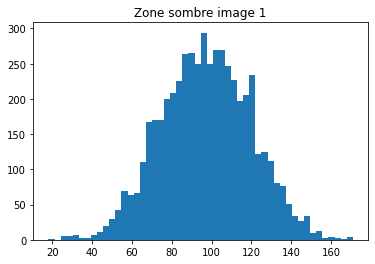

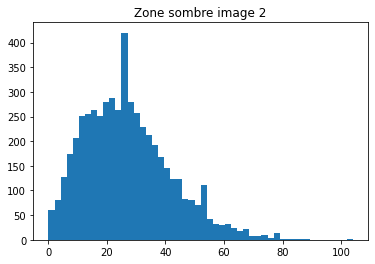

In [ ]:

# sélectionner une zone homogène pour étudier l'histogramme
# on pourra utiliser la zone de 45 à 120 et de 175 à 245
affiche(im_obs[45:120,175:245],MINI=0.0, MAXI=255.,titre="Image bruitee",printname=True)

plt.figure()
plt.hist(im_obs[45:120,175:245].flatten(),50)
plt.title('Zone sombre image 1')
plt.show()

plt.figure()
plt.hist(im_obs2[45:120,175:245].flatten(),50)
plt.title('Zone sombre image 2')
plt.show()




Nous allons comparer trois modèles *a priori*: le modèle de Potts $\delta_{x_p=x_q}$, la variation totale (discrète) $|x_p-x_q|$, et le modèle gaussien (quadratique) $(x_p-x_q)^2$.

3. S'agit-il de métriques ou de semi-métriques ? Qu'en déduire sur la méthode d'optimisation à utiliser ?


**Votre réponse &#x270D;** : 



*   Modèle de Potts: Metrique (vérifie l'inégalité triangulaire), l'alpha-beta swap et l'alpha-expansions.
*   Variation totale: Metrique, l'alpha-beta swap et l'alpha-expansions.
*   Modèle Gaussien: Seime-metrique, seulement l'alpha-beta swap;







4. Quelle sont les differences entre la méthode de l'alpha-expansion et la méthode de l'alpha-beta swap ?





**Votre réponse &#x270D;** : 



*   Construction du graphe différente. Pour l'alpha-beta swap, construction d'un graphe à partir des seuls pixels étiquetés $\alpha$ ou $\beta$. Pour l'alpha-expansions, construction d'un graphe à partir de tous les pixels
*   Stratégie de parcours différente. Pour l'alpha-beta swap, tirer de 2 en 2. Pour l'alpha-expansions, parcourir toutes les classes.
*   Contrainte sur l'énergie potentiel de régularisation es différent: semi-métrique pour l'alpha-beta swap et métrique pour l'alpha-expansions.





Dans les parties suivantes nous allons utiliser les fonctions aexpansion_grid et abswap_grid qui réalisent respectivement l'alpha-expansion et l'alpha-beta swap. Ces fonctions prennent en entrée deux arguments pour un nombre de niveaux L :
- un tenseur de la taille de l'image contenant dans la 3ième dimension l'attache aux données de chaque pixel pour chaque niveau considéré (terme unaire)
- une matrice contenant les valeurs des termes d'interaction entre deux niveaux $l_1$ et $l_2$ (dépend du potentiel d'interaction choisi)

### 2.1 Débruitage dans le cas gaussien (image synthétique)

In [ ]:
from maxflow.fastmin import aexpansion_grid, abswap_grid

# Loading image
# Chargment des images

im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Image observée, bruitée
im_obs2=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee2.png')*255 # Image observée, bruitée
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Image binaire de réference, pour évaluer la qualité de la segmentation

I = im_obs

I = I*255/I.max()
L = 30
# Generates L gray levels for nearsest prototype labeling
levs = np.arange(0, 255, 255/L)
# Calculate data cost as the absolute difference between the label prototype and the pixel value
D = np.double(np.abs((I.reshape(I.shape+(1,)) - levs.reshape((1,1,-1)))**2))   

affiche(I,MINI=0.0, MAXI=255.,titre="Image bruitee",printname=True)

# Generate nearest prototype labeling
Id = np.argmin(D,2)
affiche(Id*255/L,MINI=0.0, MAXI=255.,titre="Débruitage au sens du Maximum de Vraisemblance",printname=True)
print(D.shape)


(323, 361, 4)


(323, 361, 4)


(323, 361, 30)


5. Ici, à quoi correspond l'array D ? Expliquez sa dimension.

**Votre réponse &#x270D;** : 

L'array D contient l'attache aux donnés pour chaque pixel (donc la taille de l'image 323 X 261) et pour chaque niveaux (donc L = 30).

Complétez les programmes ci-dessous, testez chaque modèle de régularisation en déterminant à chaque fois une valeur appropriée de beta.

In [ ]:
# régularisation modèle de Potts
# valeurs de beta de plusieurs centaines
beta_Potts = 2000 
# définition de la matrice de régularisation V(i,j) pour le modèle de Potts
V_Potts = np.double(beta_Potts*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))>0))
affiche(V_Potts)

# Effectue l'apha-expansion en fonction de l'attache aux données D et de la régularisation V
labels_Potts = aexpansion_grid(D,V_Potts)  
affiche(labels_Potts*255/L,MINI=0.0, MAXI=255.0,titre="Débruitage par Graph Cut, regularisation Potts, beta = " + str(beta_Potts),printname=True)

(30, 30, 4)


(323, 361, 4)


In [ ]:
# régularisation modèle TV
# valeur de beta de l'ordre des dizaines
beta_TV = 40
# définition de la matrice de régularisation V(i,j) pour le modèle de TV 
V_TV = np.double(beta_TV*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))))
affiche(V_TV)

# Effectue l'aphaexpension en fonction de l'attache aux données D et de la rédularisation V
labels_TV = aexpansion_grid(D,V_TV)
print("Calcul TV terminé")
affiche(labels_TV*255/L,MINI=0.0, MAXI=255.0,titre="Débruitage par Graph Cut, regularisation TV, beta = " + str(beta_TV),printname=True)

(30, 30, 4)


Calcul TV terminé
(323, 361, 4)


In [ ]:
# régularisation modèle quadratique
# valeur de beta de l'ordre des dizaines
beta_quadratic = 4
# définition de la matrice de régularisation V(i,j) pour le modèle quadratique 
V_quadratic = np.double(beta_quadratic*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1))))**2)
affiche(V_quadratic)

# Effectue l'apha-beta swap en fonction de l'attache aux données D et de la rédularisation V
labels_Quadratic = aexpansion_grid(D,V_quadratic)
affiche(labels_Quadratic*255/L,MINI=0.0, MAXI=255,titre="Débruitage par Graph Cut, regularisation Quadratic, beta = " + str(beta_quadratic),printname=True)

(30, 30, 4)


(323, 361, 4)


8. Quel modèle de régularisation vous semble le plus adapté ? Donnez le meilleur paramètre de régularisation visuellement trouvé et commentez les résultats que vous obtenez dans chacun des trois cas.

**Votre réponse &#x270D;** : 

Pour cette image qui est par morceau, le modèle de Potts nous donne un meilleur résultat. Le meilleur paramètre de régularisation est: 2000; 40 et 4, respectivement.



### 2.2 Débruitage dans le cas du bruit de speckle (image synthétique)

Modifiez les cellules suivantes pour adapter le modèle au débruitage de l'image im_obs2.

9. Quelles modifications sont nécessaires ? (Il y en a plusieurs !)

**Votre réponse &#x270D;** : 

Nous devons changer le calcul de l' attache aux données (le calcul de D).



In [12]:
from maxflow.fastmin import aexpansion_grid
from numpy import log

# Loading image
im_obs2=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee2.png')*255 # Image observée, bruitée
I = im_obs2
I = I*255/I.max()
affiche(I,MINI=0.0, MAXI=255.,titre="Image bruitee 2",printname=True)

L = 30
# Generates L gray levels for nearsest prototype labeling
levs = np.arange(1/L, 255, 255/L)

# Calculate data cost as the absolute difference between the label prototype and the pixel value
D = -log(2*I.reshape(I.shape+(1,))/levs.reshape((1,1,-1))**2)+(I.reshape(I.shape+(1,))**2/levs.reshape((1,1,-1))**2)
print()
Id = np.argmin(D,2)

# Generate nearest prototype labeling
Id = np.argmin(D,2)
affiche(Id/L*255,MINI=0.0, MAXI=255.,titre="Débruitage au sens du Maximum de Vraisemblance",printname=True)

(323, 361, 4)



(323, 361, 4)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in log
  from ipykernel import kernelapp as app


In [ ]:
# valeur de beta de l'ordre des dixièmes d'unité
beta_Potts = 0.5
# définition de la matrice de régularisation V(i,j) pour le modèle de Potts
V_Potts = np.double(beta_Potts*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))>0))

# Effectue l'apha-expansion en fonction de l'attache aux données D et de la régularisation V
labels_Potts = aexpansion_grid(D,V_Potts)  
affiche(labels_Potts*255/L,MINI=0.0, MAXI=255.0,titre="Débruitage par Graph Cut, regularisation Potts, beta = " + str(beta_Potts),printname=True)


(323, 361, 4)


In [ ]:
# valeur de beta lors des centièmes d'unité
beta_TV = 0.02
# définition de la matrice de régularisation V(i,j) pour le modèle de TV 
V_TV = np.double(beta_TV*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))))

# Effectue l'aphaexpension en fonction de l'attache aux données D et de la rédularisation V
labels_TV = aexpansion_grid(D,V_TV)
print("Calcul TV terminé")
affiche(labels_TV*255/L,MINI=0.0, MAXI=255.0,titre="Débruitage par Graph Cut, regularisation TV, beta = " + str(beta_TV),printname=True)


Calcul TV terminé
(323, 361, 4)


In [ ]:
# valeur de beta de l'ordre des millièmes d'unité
beta_quadratic = 0.001
# définition de la matrice de régularisation V(i,j) pour le modèle quadratique 
V_quadratic = np.double(beta_quadratic*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1))))**2)

# Effectue l'apha-beta swap en fonction de l'attache aux données D et de la rédularisation V
labels_Quadratic = aexpansion_grid(D,V_quadratic)
affiche(labels_Quadratic*255/L,MINI=0.0, MAXI=255,titre="Débruitage par Graph Cut, regularisation Quadratic, beta = " + str(beta_quadratic),printname=True)


(323, 361, 4)


### 2.3 Débruitage d'une image naturelle

Appliquez une des méthodes utilisées plus haut pour débruiter l'image bruitée de cameraman. Justifiez votre choix.

Commentez le résultat obtenu.



**Votre réponse &#x270D;** : 

Il y a plus d'intéresse en utiliser TV, parce qu’il n'est pas une image par morceau. Comme TV est une mètrique, nous pouvons utiliser l'alpha-expansion.


Nous pouvons dire que pour la valeur bêta choisie, le résultat n'était pas très bon. Nous avons réussi à récupérer le contour des objets de l'image, comme l'homme et la caméra, mais pas les bâtiments en arrière-plan. Il est à noter que le bruit dans l'image était très fort, il n'était donc pas prévu d'obtenir quelque chose de très proche de l'image d'origine.


In [4]:
from skimage.color import rgb2gray


import imageio
I_cameraman = imageio.imread('https://homepages.cae.wisc.edu/~ece533/images/cameraman.tif')
I_cameraman_bruit = I_cameraman + np.random.normal(0,80,I_cameraman.shape)
I_cameraman_bruit[I_cameraman_bruit<0] = 0
I_cameraman_bruit[I_cameraman_bruit>255] = 255
print(I_cameraman.max())

affiche(I_cameraman,MINI=0.0, MAXI=255.,titre="Image non bruitée",printname=True)
affiche(I_cameraman_bruit,MINI=0.0, MAXI=255.,titre="Image bruitée",printname=True)


253
(256, 256, 4)


(256, 256, 4)


In [9]:
from maxflow.fastmin import aexpansion_grid

I = 255*I_cameraman_bruit/I_cameraman_bruit.max()
L = 250
# Generates L gray levels for nearsest prototype labeling
levs = np.arange(0,255,255/L)
# Calculate data cost as the absolute difference between the label prototype and the pixel value
D = np.double(np.abs((I.reshape(I.shape+(1,))- levs.reshape((1,1,-1)))**2))

# choose a regularization model and compute V matrix
Id= np.argmin(D,2)
affiche(Id, MINI=0.0,MAXI=None, titre="Débruitage au sens du Maximum de Vraissemblance",printname=True)
beta_TV= 120  
V_TV = np.double(beta_TV*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))))

# compute the appropriate optimization
labels_TV=aexpansion_grid(D,V_TV)

# display the regularized image 
affiche(labels_TV, MINI=0.0,MAXI=None,titre="Débruitage par Graph Cut, regularisation Quadratic, beta = " + str(beta_TV),printname=True)

(256, 256, 4)


(256, 256, 4)


### 2.3 Débruitage d'une image SAR

L'imagerie SAR (Synthetic Aperture Radar) est une modalité de télédetection basée sur le radar qui permet d'obtenir des images de la Terre quelque soient la luminosité et les conditions météorologiques. Un inconvénient majeur est le fort bruit de speckle qui les affecte. La cellule suivante charge une image en amplitude acquise par le satellite Sentinel 1-A sur la ville de Des Moines aux États-Unis. Pour limiter les temps de calculs, on travaillera sur un petit rectangle issu de l'image fournie.

Adaptez une des méthodes utilisée précedemment pour débruiter l'image fournie. On supposera que le bruit suit une distribution de Rayleigh.

Commentez le résultat obtenu.

On pourra comparer le résultat avec un débruitage obtenu par une méthode plus récente (SAR2SAR), basée sur une approche Deep Learning (le code pour l'afficher est fourni plus bas).

**Votre réponse &#x270D;** : 

Nous avons obtenu un résultat relativement bon en utilisant la TV pour le beta choisie, compte tenu de la quantité de bruit que nous avions. Nous avons obtenu correctement une image débruitée, mais nous avons perdu en certains points le contour de la rivière. Le résultat obtenu par la méthode SAR2SAR est de loin supérieur et de plus, nous avons pu effectuer le débruitage complet de l'image dans un temps similaire à l'expantion alpha pour une petite partie.

--2021-01-22 23:23:29--  https://www.dropbox.com/s/7m2dw3irho8dpzj/noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/7m2dw3irho8dpzj/noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy [following]
--2021-01-22 23:23:30--  https://www.dropbox.com/s/dl/7m2dw3irho8dpzj/noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc9449863961b57187d229691a3c.dl.dropboxusercontent.com/cd/0/get/BHgh0_egm9jXM50gUvo5yyqEsjGRhK_jFI82a4HYZQaFcuWLbpmwqj8pxLJtKc9W-8levOu4nAl2uuZM4wV5Tfpq-33vtd51IVIP-ZGFnDNdz2yjChBn_daZJS7Qb1Uyro0/file?dl=1# [following]
--2021-01-22 23:23:30--  https://uc9449863961b57187d229691a3c.dl.dropboxusercontent.com/cd/0/ge

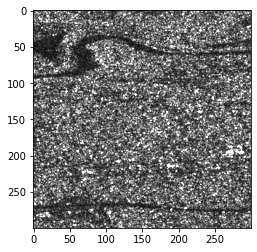

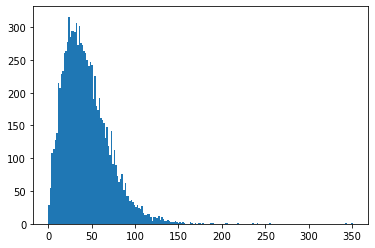

In [10]:
try:
    I_SAR = np.load('noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1')
except:
    !wget 'https://www.dropbox.com/s/7m2dw3irho8dpzj/noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1'
    I_SAR = np.load('noisy_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1')

affiche(I_SAR,0,100,'Image complete')
I_SAR = I_SAR[0:300,0:300]
plt.figure()
plt.imshow(I_SAR,vmax = 100, cmap = 'gray') # L'affichage se fait en tronquant la dynamique
plt.show()

plt.figure()
plt.hist(I_SAR[100:200,100:200].flatten(),200) # Affichage de l'histogramme sur une zone presque homogène
plt.show()


(300, 300, 4)


(300, 300, 4)


(300, 300, 4)


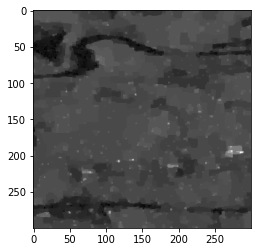

In [16]:
from numpy import log
I = I_SAR*255/I_SAR.max()
L = 255
# Generates L gray levels for nearsest prototype labeling
levs = np.arange(1/L,255,255/L)
# Calculate data cost as the neg-log likelihood
D = -log(2*I.reshape(I.shape+(1,))/levs.reshape((1,1,-1))**2)+(I.reshape(I.shape+(1,))**2/levs.reshape((1,1,-1))**2)
print()
affiche(I,MINI=0.0, MAXI=100,titre="Image bruitee",printname=True)

# choose a regularization model and compute V matrix
Id= np.argmin(D,2)
affiche(Id, MINI=0.0,MAXI=None, titre="Débruitage au sens du Maximum de Vraissemblance",printname=True)

beta_TV= 0.15  
V_TV = np.double(beta_TV*(np.abs( levs.reshape((-1,1)) - levs.reshape((1,-1)))))

# compute the appropriate optimization
labels_TV=aexpansion_grid(D,V_TV)

# display the regularized image 
affiche(labels_TV, MINI=0.0,MAXI=None,titre="Débruitage par Graph Cut, regularisation Quadratic, beta = " + str(beta_TV),printname=True)
plt.figure()
plt.imshow(labels_TV,cmap='gray')
plt.show()

--2021-01-22 23:32:04--  https://www.dropbox.com/s/0f6l0qr6teck5bd/denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/0f6l0qr6teck5bd/denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy [following]
--2021-01-22 23:32:05--  https://www.dropbox.com/s/dl/0f6l0qr6teck5bd/denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucc01a4cfa4a316738f0a077db16.dl.dropboxusercontent.com/cd/0/get/BHg6gNMwy-CbY2Q5fRYPzNl2-j_BCVfSoyO3BFpBK8UUxRilACdC1o0F54aBu5ZnnUoebO9n2p9A7RuntS2R2QJw2DS6vR04uRypw-2UQswmBuxIf8_DXSrb5uTsPAaJhJ4/file?dl=1# [following]
--2021-01-22 23:32:05--  https://ucc01a4cfa4a316738f0a077db16.dl.dropboxusercontent.co

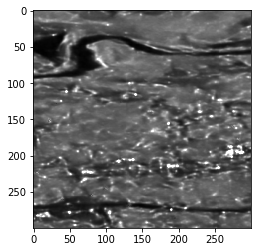

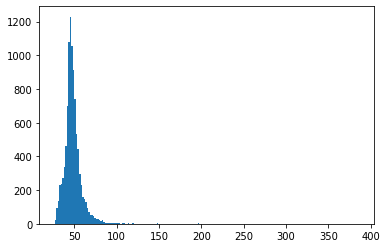

In [17]:
# Affichage de l'image débruitée par la méthode SAR2SAR

try:
    I_SAR = np.load('denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1')
except:
    !wget 'https://www.dropbox.com/s/0f6l0qr6teck5bd/denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1'
    I_SAR = np.load('denoised_DesMoines_dual_1_corrige_1_VV_AMPLITUDE.npy?dl=1')

affiche(I_SAR,0,100,'Image complete')
I_SAR = I_SAR[0:300,0:300]
plt.figure()
plt.imshow(I_SAR,vmax = 100, cmap = 'gray') # L'affichage se fait en tronquant la dynamique
plt.show()

plt.figure()
plt.hist(I_SAR[100:200,100:200].flatten(),200) # Affichage de l'histogramme sur une zone presque homogène
plt.show()